In [1]:
from keras.layers import Conv2D, UpSampling2D, InputLayer, Conv2DTranspose
from keras.layers import Activation, Dense, Dropout, Flatten
from keras.layers.normalization import BatchNormalization
from keras.models import Sequential, load_model
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from skimage.color import rgb2lab, lab2rgb, rgb2gray, gray2rgb
from skimage.io import imsave
from skimage.transform import resize
import numpy as np
import os
import random
import tensorflow as tf
import matplotlib.pyplot as plt
import pickle

Using TensorFlow backend.


In [2]:
inception = load_model('inception_resnet_v2_model.h5')

/home/ubuntu/anaconda3/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [3]:
inception._make_predict_function()

In [4]:
def show_gray_image(image):
    plt.imshow(rgb2lab(image)[:,:,0]*255/100, cmap='gray')

In [5]:
# takes pixels values between [0, 255] and scales values between [-1,1]
def preprocess_input(im):
    return 2*(im/255.0)-1.0

In [6]:
# takes pixel values between [0, 255] and returns gray image of dim-3 between [0,1]
def turn_gray(im):
    return gray2rgb(rgb2lab(im/255)[:,:,0]/100)

In [7]:
def embed(images):
    images = preprocess_input(turn_gray(images)*255)
    images = resize(images, (images.shape[0], 299, 299, 3))
    return inception.predict(images)

In [8]:
model = load_model('lake_final_model.h5')

In [9]:
worse_model = load_model('best_model_lake.h5')

In [11]:
try:
    with open('X_lake.pkl', 'rb') as handle:
        X = pickle.load(handle)
except:
    path = './unzipped_images/lake/'
    X = []
    for filename in os.listdir(path)[-500:]:
        X.append(img_to_array(load_img(path + filename))/255)
    X = np.array(X)
    with open('X_lake.pkl', 'wb') as handle:
        pickle.dump(X, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [12]:
X_lab = rgb2lab(X)

In [13]:
X_L = X_lab[:,:,:,0].reshape(X_lab[:,:,:,0].shape + (1,))
X_ab = X_lab[:,:,:,1:]

In [14]:
# predictions = model.predict([X_L[:8]/100, embed(X[:8]*255)], batch_size=8)

In [15]:
# predictions.shape

In [16]:
# recolored_images = []
# for image in np.concatenate([X_L[:8], predictions*128], axis=-1):
#     recolored_images.append(lab2rgb(image))
# recolored_images = np.array(recolored_images)

In [18]:
try:
    with open('recolored_lake.pkl', 'rb') as handle:
        recolored_images_worse = pickle.load(handle)
    
except Exception as e:
    print(e)
    predictions = worse_model.predict(X_L/100, batch_size=8)
    
    recolored_images_worse = []
    for image in np.concatenate([X_L, predictions*128], axis=-1):
        recolored_images_worse.append(lab2rgb(image))
    recolored_images_worse = np.array(recolored_images_worse)
    with open('recolored_lake.pkl', 'wb') as handle:
        pickle.dump(recolored_images_worse, handle, protocol=pickle.HIGHEST_PROTOCOL)

Ran out of input


In [19]:
try:
    with open('recolored_lake_final.pkl', 'rb') as handle:
        recolored_images = pickle.load(handle)
    
except Exception as e:
    print(e)
    predictions = model.predict([X_L/100, embed(X*255)], batch_size=8)
    
    recolored_images = []
    for image in np.concatenate([X_L, predictions*128], axis=-1):
        recolored_images.append(lab2rgb(image))
    recolored_images = np.array(recolored_images)
    with open('recolored_lake_final.pkl', 'wb') as handle:
        pickle.dump(recolored_images, handle, protocol=pickle.HIGHEST_PROTOCOL)

[Errno 2] No such file or directory: 'recolored_lake_final.pkl'


/home/ubuntu/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/ubuntu/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
/home/ubuntu/anaconda3/lib/python3.6/site-packages/skimage/color/colorconv.py:993: UserWarning: Color data out of range: Z < 0 in 5475 pixels
  warn('Color data out of range: Z < 0 in %s pixels' % invalid[0].size)
/home/ubuntu/anaconda3/lib/python3.6/site-packages/skimage/color/colorconv.py:993: UserWarning: Color data out of range: Z < 0 in 28 pixels
  warn('Color data out of range: Z < 0 in %s pixels' % invalid[0].size)
/home/ubuntu/anaconda3/lib/python3.6/site-packages

00001381.jpg


/home/ubuntu/anaconda3/lib/python3.6/site-packages/skimage/util/dtype.py:141: UserWarning: Possible precision loss when converting from float64 to uint8
  .format(dtypeobj_in, dtypeobj_out))


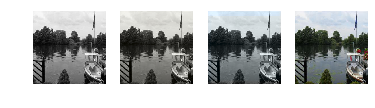

00000749.jpg


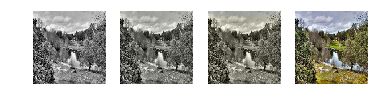

00002428.jpg


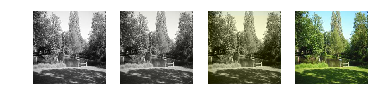

00000133.jpg


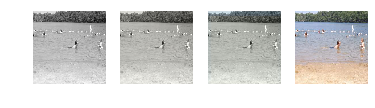

00002817.jpg


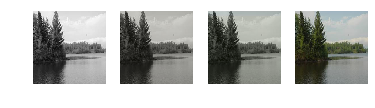

00001768.jpg


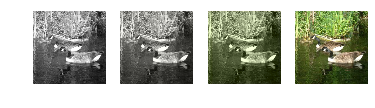

00000676.jpg


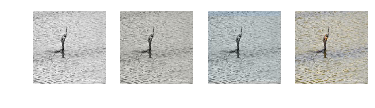

00003465.jpg


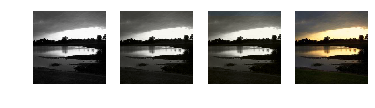

00001518.jpg


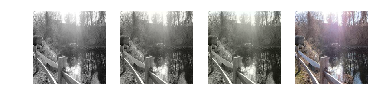

00002078.jpg


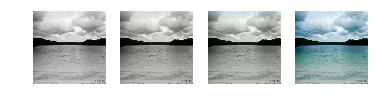

00000600.jpg


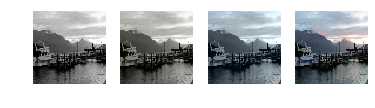

00004061.jpg


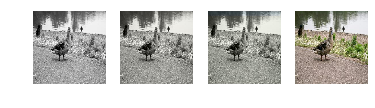

00000258.jpg


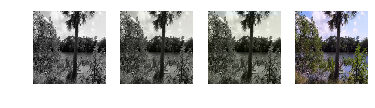

00001961.jpg


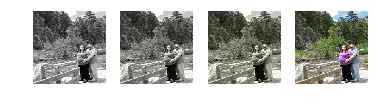

00002126.jpg


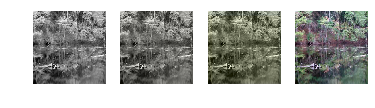

00001883.jpg


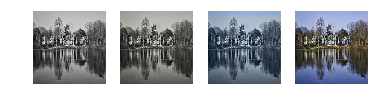

00004081.jpg


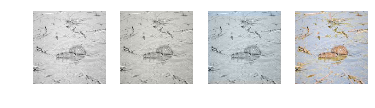

00000416.jpg


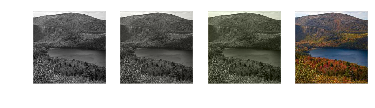

00000544.jpg


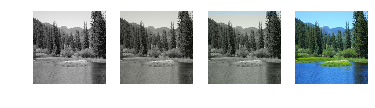

00003116.jpg


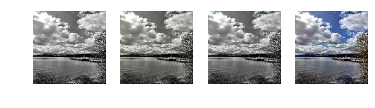

00000714.jpg


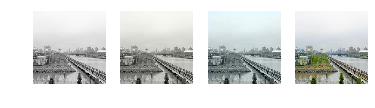

00002635.jpg


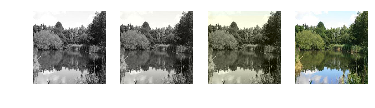

00004249.jpg


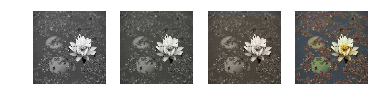

00004854.jpg


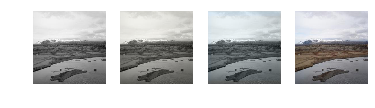

00003496.jpg


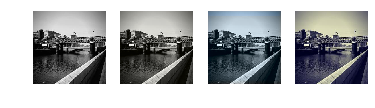

00004954.jpg


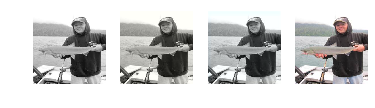

00000784.jpg


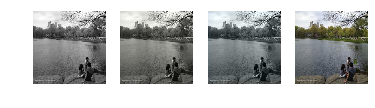

00001618.jpg


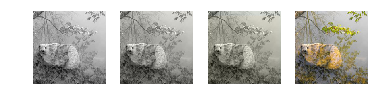

00002667.jpg


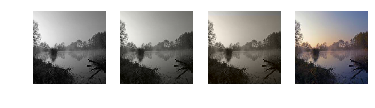

00001347.jpg


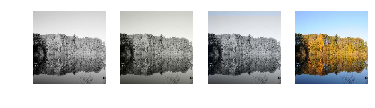

00002819.jpg


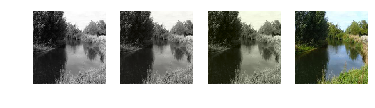

00002440.jpg


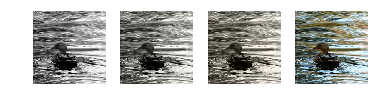

00000522.jpg


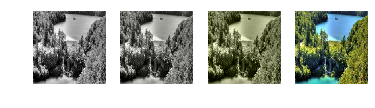

00000280.jpg


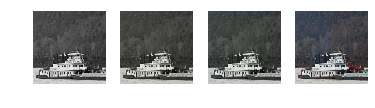

00001674.jpg


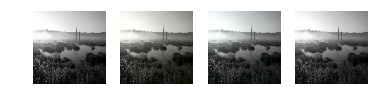

00003123.jpg


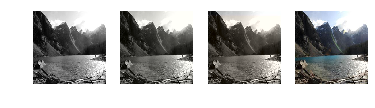

00004695.jpg


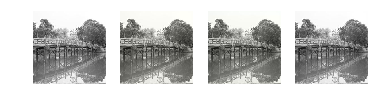

00001134.jpg


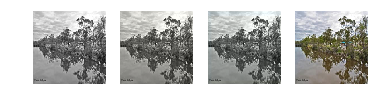

00000725.jpg


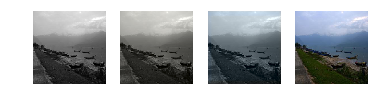

00003618.jpg


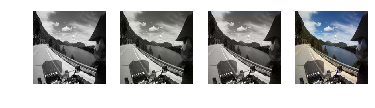

00002449.jpg


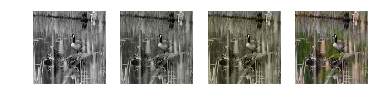

00000473.jpg


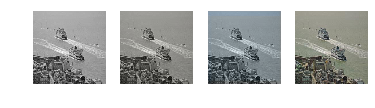

00001290.jpg


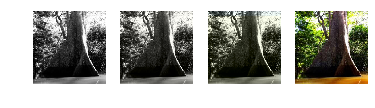

00004813.jpg


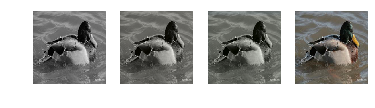

00001282.jpg


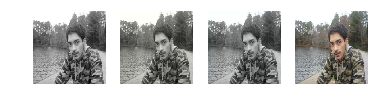

00001274.jpg


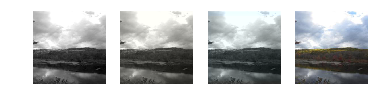

00003703.jpg


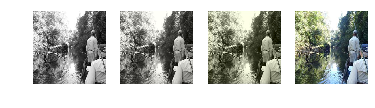

00004350.jpg


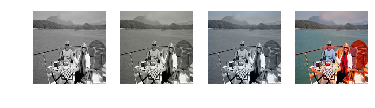

00003986.jpg


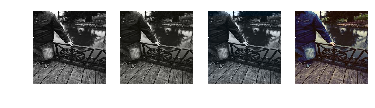

00000550.jpg


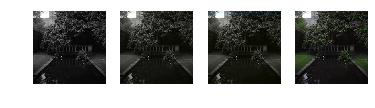

00002854.jpg


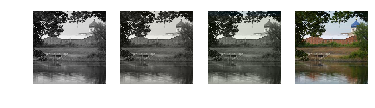

00003716.jpg


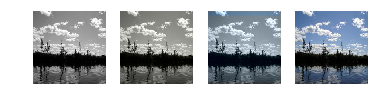

00001869.jpg


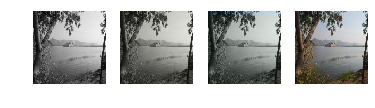

00004136.jpg


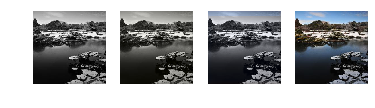

00000999.jpg


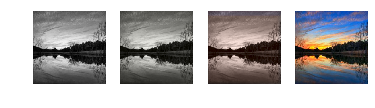

00004360.jpg


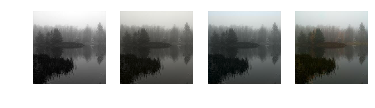

00003660.jpg


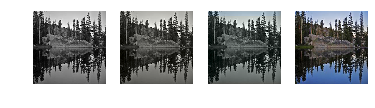

00004248.jpg


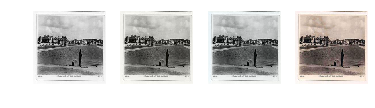

00004729.jpg


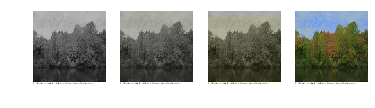

00001179.jpg


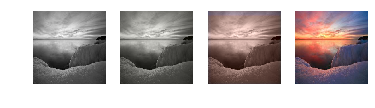

00004571.jpg


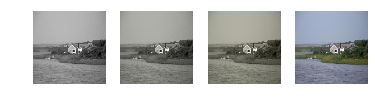

00002389.jpg


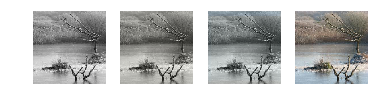

00003970.jpg


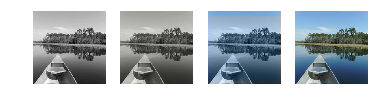

00003462.jpg


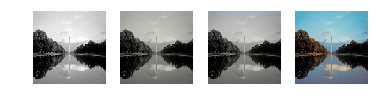

00004024.jpg


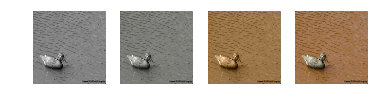

00000568.jpg


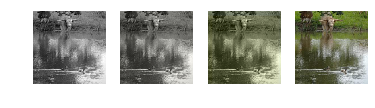

00003589.jpg


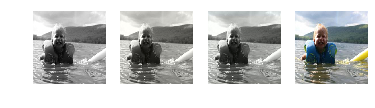

00002835.jpg


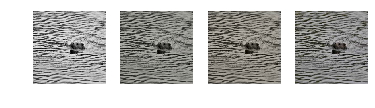

00000889.jpg


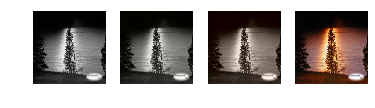

00002322.jpg


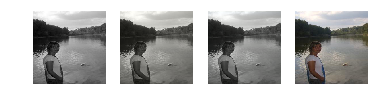

00000040.jpg


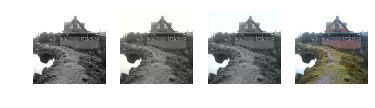

00003607.jpg


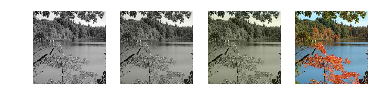

00001802.jpg


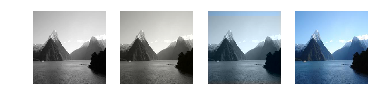

00004274.jpg


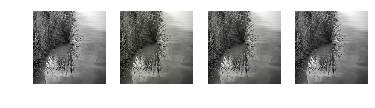

00001329.jpg


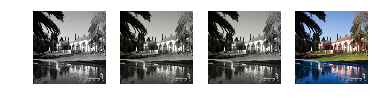

00002143.jpg


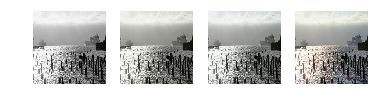

00000442.jpg


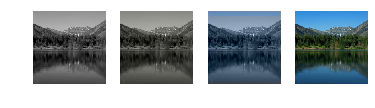

00002482.jpg


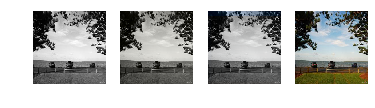

00001713.jpg


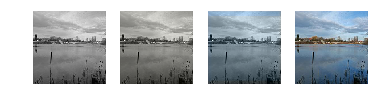

00000295.jpg


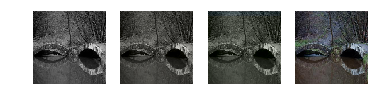

00002580.jpg


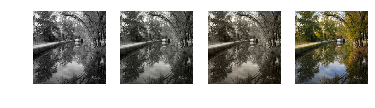

00001680.jpg


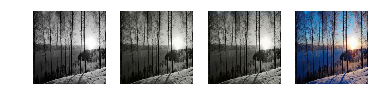

00001494.jpg


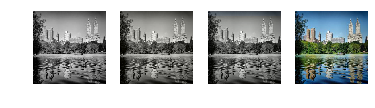

00004014.jpg


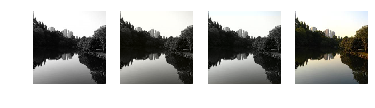

00000599.jpg


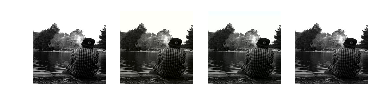

00002537.jpg


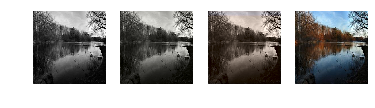

00001959.jpg


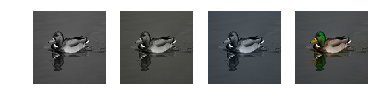

00003799.jpg


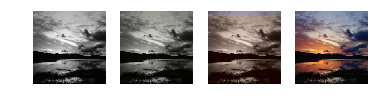

00003792.jpg


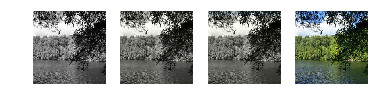

00000721.jpg


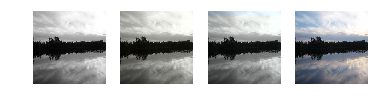

00000510.jpg


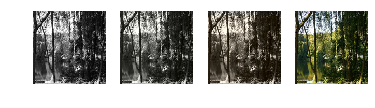

00004349.jpg


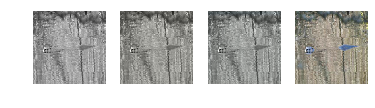

00001921.jpg


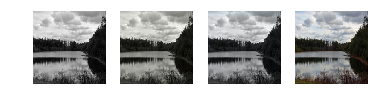

00001950.jpg


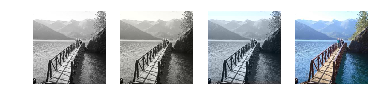

00001958.jpg


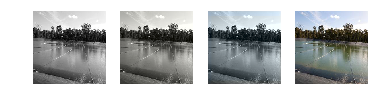

00004091.jpg


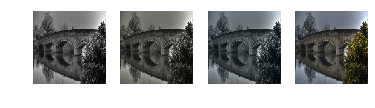

00002532.jpg


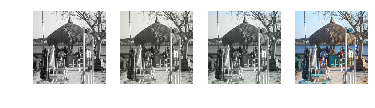

00001760.jpg


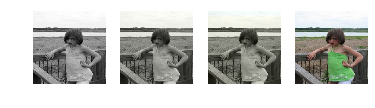

00000126.jpg


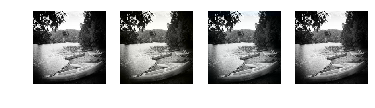

00002279.jpg


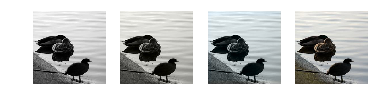

00002664.jpg


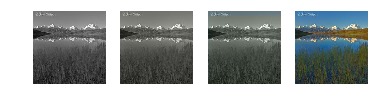

00004451.jpg


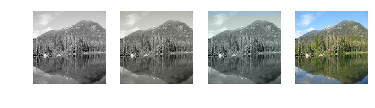

00002702.jpg


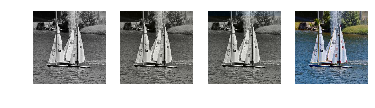

00002903.jpg


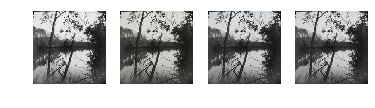

00003445.jpg


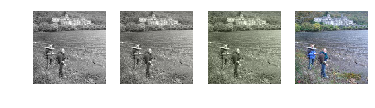

00000293.jpg


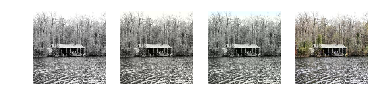

00001925.jpg


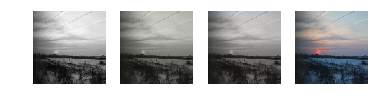

00003312.jpg


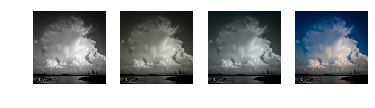

00003031.jpg


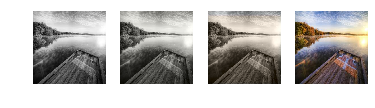

00001320.jpg


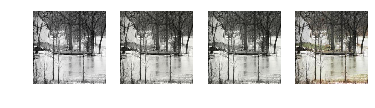

00001848.jpg


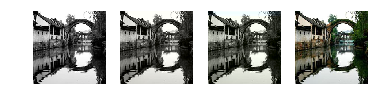

00002559.jpg


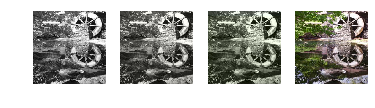

00001477.jpg


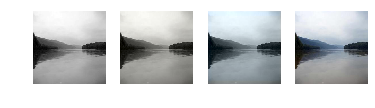

00003295.jpg


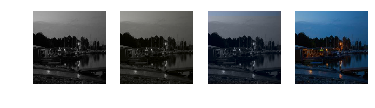

00004498.jpg


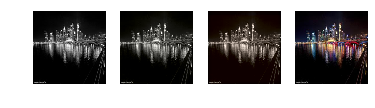

00003591.jpg


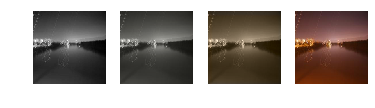

00003782.jpg


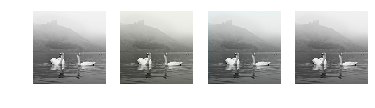

00001523.jpg


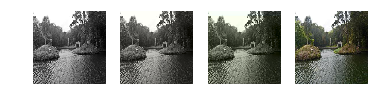

00001658.jpg


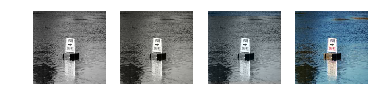

00000554.jpg


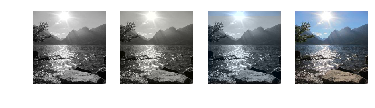

00002874.jpg


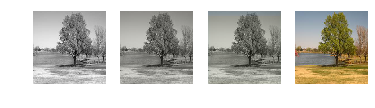

00000817.jpg


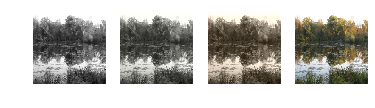

00000118.jpg


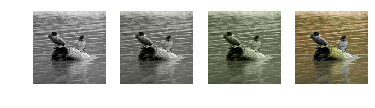

00004779.jpg


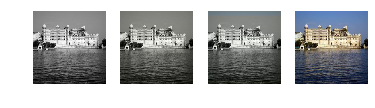

00003314.jpg


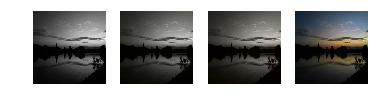

00004754.jpg


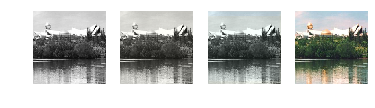

00000478.jpg


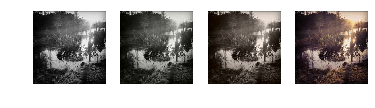

00004714.jpg


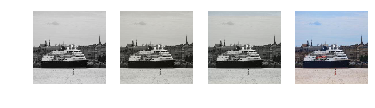

00003913.jpg


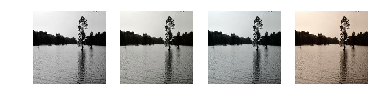

00001604.jpg


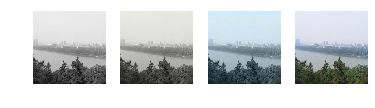

00001657.jpg


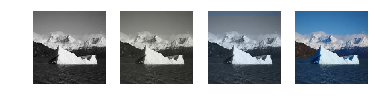

00001864.jpg


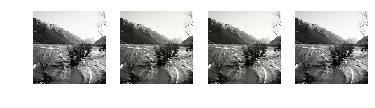

00003304.jpg


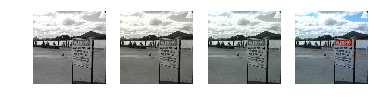

00002585.jpg


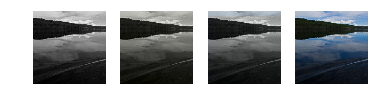

00003768.jpg


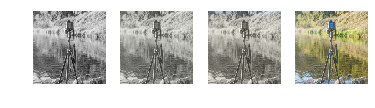

00000582.jpg


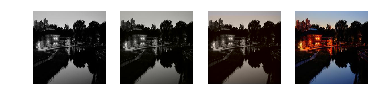

00003017.jpg


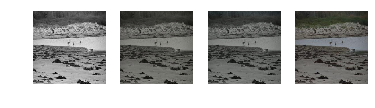

00004519.jpg


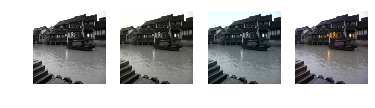

00003556.jpg


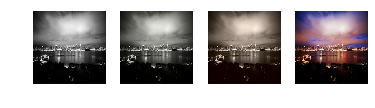

00001022.jpg


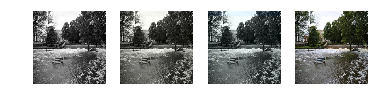

00003096.jpg


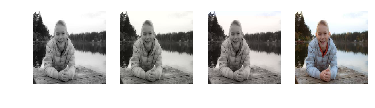

00000848.jpg


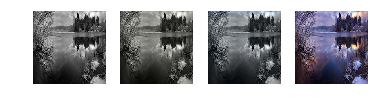

00002253.jpg


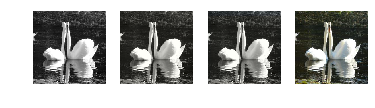

00001146.jpg


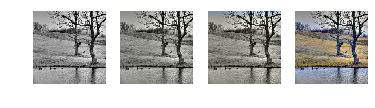

00000153.jpg


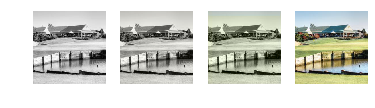

00001791.jpg


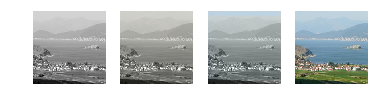

00000823.jpg


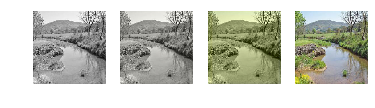

00004382.jpg


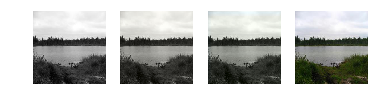

00004867.jpg


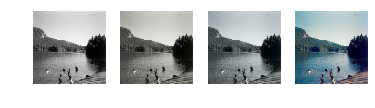

00000989.jpg


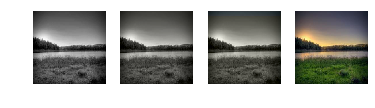

00002282.jpg


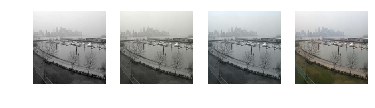

00003621.jpg


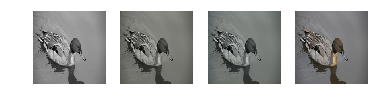

00000920.jpg


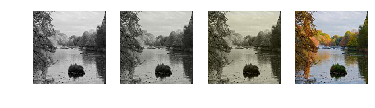

00000978.jpg


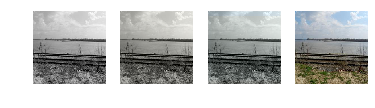

00002734.jpg


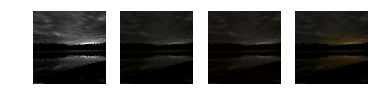

00004661.jpg


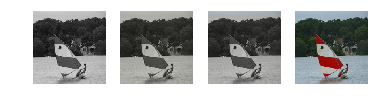

00003145.jpg


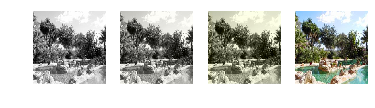

00001860.jpg


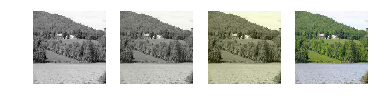

00001436.jpg


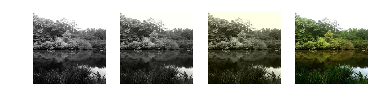

00000368.jpg


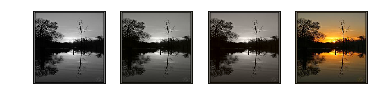

00003923.jpg


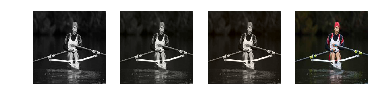

00000516.jpg


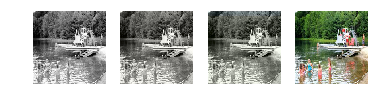

00002767.jpg


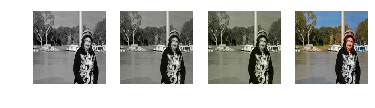

00001114.jpg


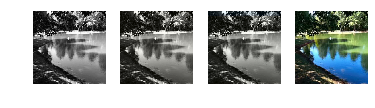

00002414.jpg


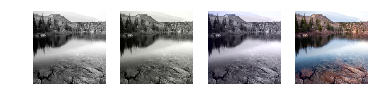

00004804.jpg


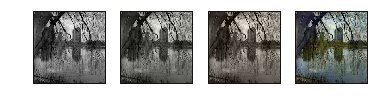

00004936.jpg


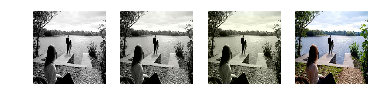

00001106.jpg


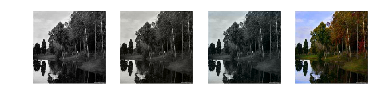

00003619.jpg


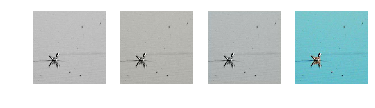

00002943.jpg


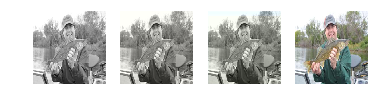

00001800.jpg


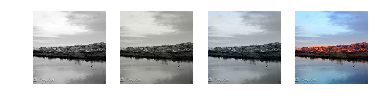

00001115.jpg


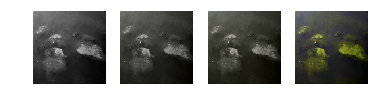

00000183.jpg


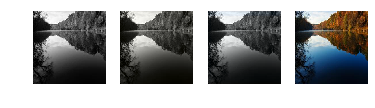

00000924.jpg


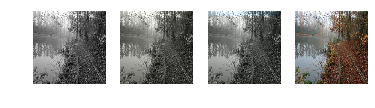

00004965.jpg


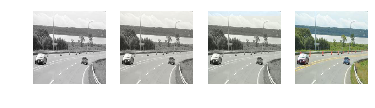

00001507.jpg


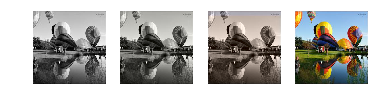

00003810.jpg


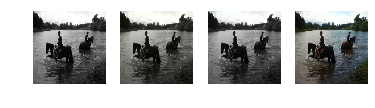

00004891.jpg


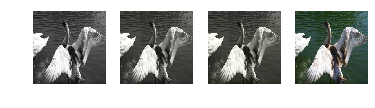

00003268.jpg


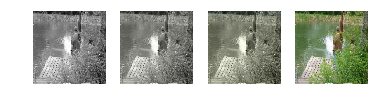

00000135.jpg


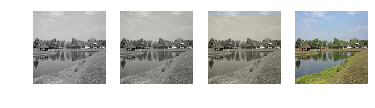

00004127.jpg


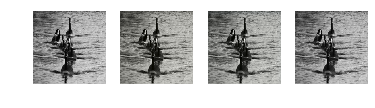

00000483.jpg


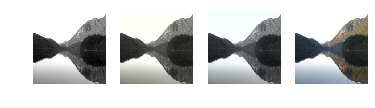

00000132.jpg


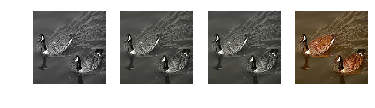

00001266.jpg


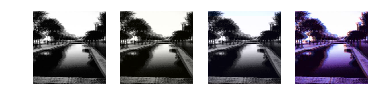

00000190.jpg


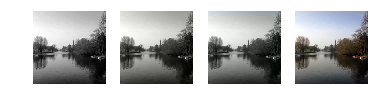

00002283.jpg


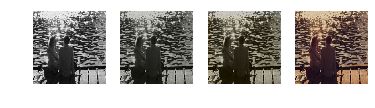

00000235.jpg


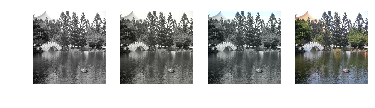

00003095.jpg


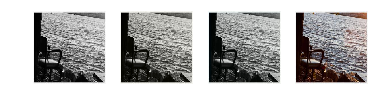

00003720.jpg


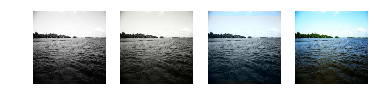

00001934.jpg


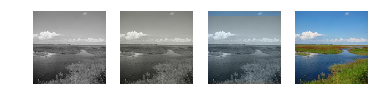

00004960.jpg


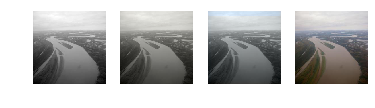

00000042.jpg


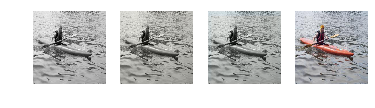

00001879.jpg


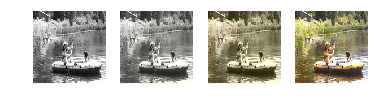

00002517.jpg


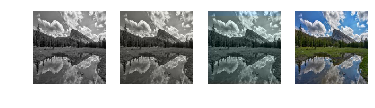

00002262.jpg


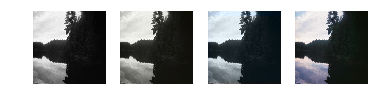

00002885.jpg


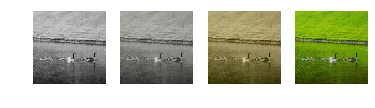

00004725.jpg


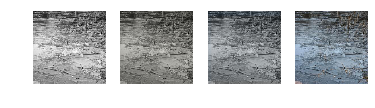

00001338.jpg


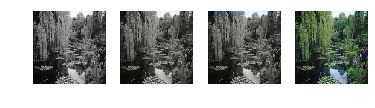

00001496.jpg


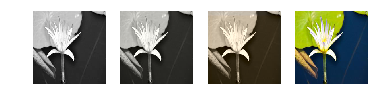

00003990.jpg


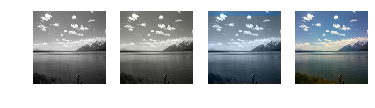

00004924.jpg


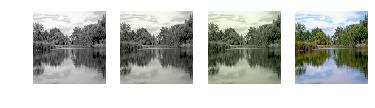

00001897.jpg


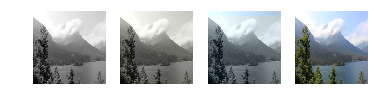

00000019.jpg


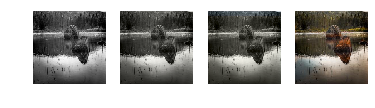

00000971.jpg


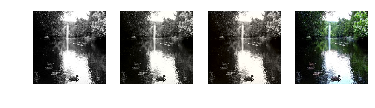

00002048.jpg


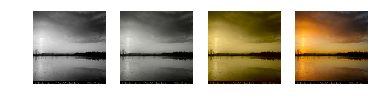

00000067.jpg


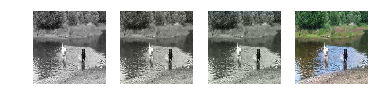

00003974.jpg


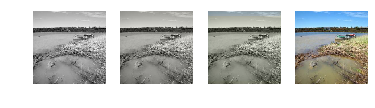

00000770.jpg


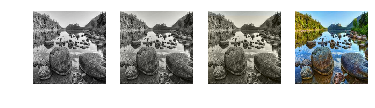

00001984.jpg


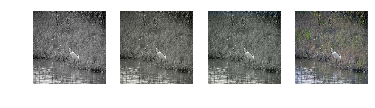

00001040.jpg


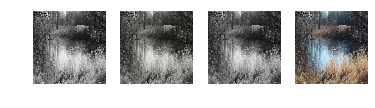

00000960.jpg


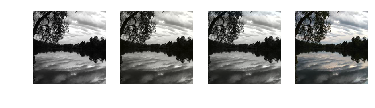

00004070.jpg


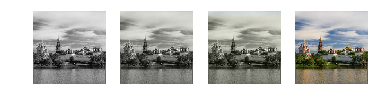

00004745.jpg


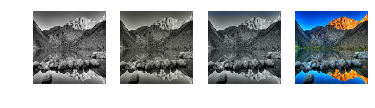

00003704.jpg


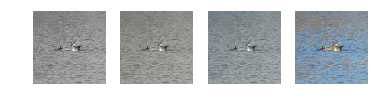

00000284.jpg


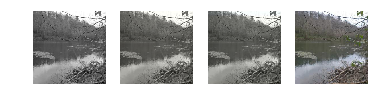

00000069.jpg


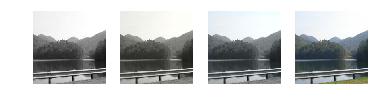

00001368.jpg


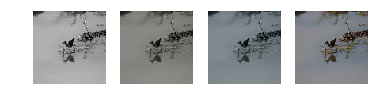

00002218.jpg


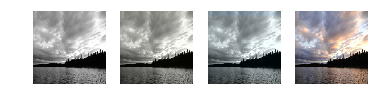

00001374.jpg


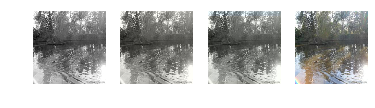

00000269.jpg


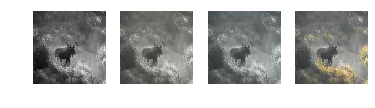

00004235.jpg


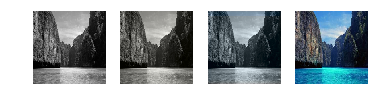

00000879.jpg


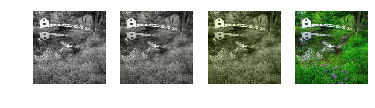

00003708.jpg


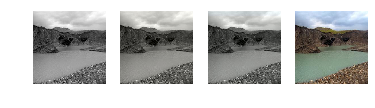

00000628.jpg


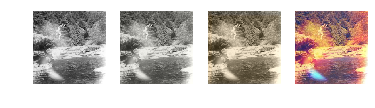

00003468.jpg


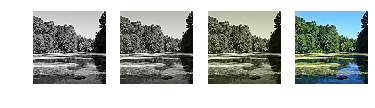

00004116.jpg


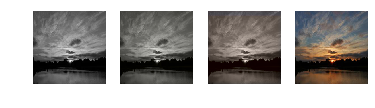

00001483.jpg


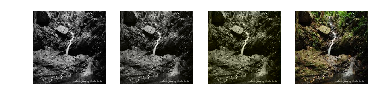

00003107.jpg


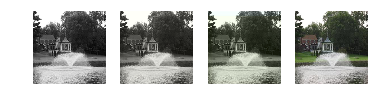

00000312.jpg


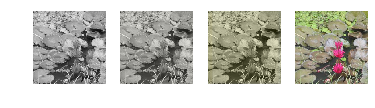

00002788.jpg


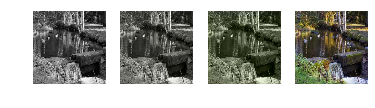

00002106.jpg


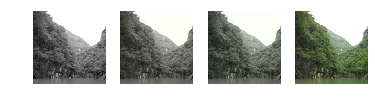

00002717.jpg


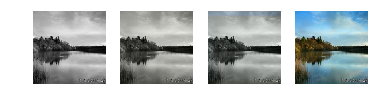

00002877.jpg


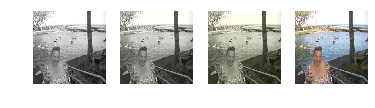

00004377.jpg


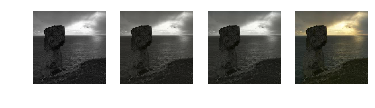

00003070.jpg


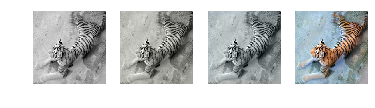

00003852.jpg


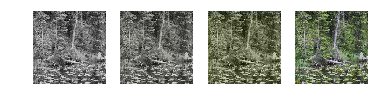

00002906.jpg


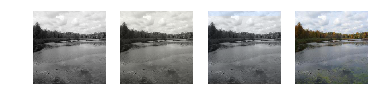

00004688.jpg


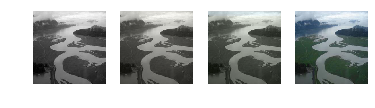

00000840.jpg


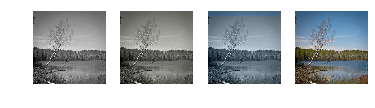

00002364.jpg


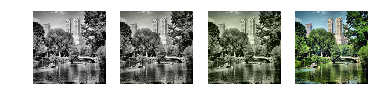

00004004.jpg


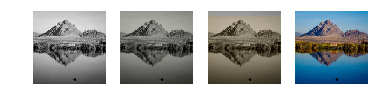

00002784.jpg


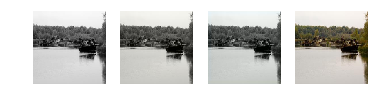

00002233.jpg


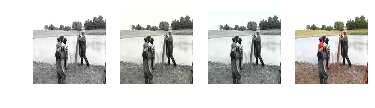

00004764.jpg


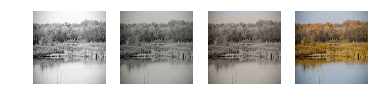

00002897.jpg


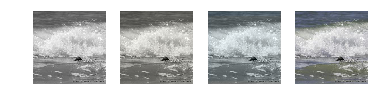

00002286.jpg


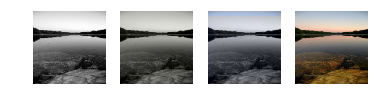

00001672.jpg


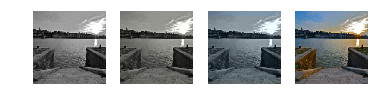

00001583.jpg


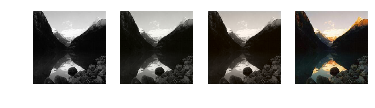

00004416.jpg


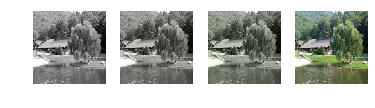

00000865.jpg


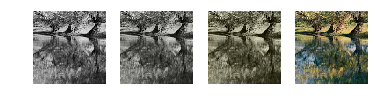

00000209.jpg


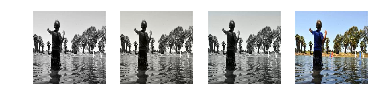

00000303.jpg


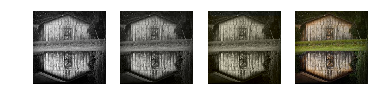

00002441.jpg


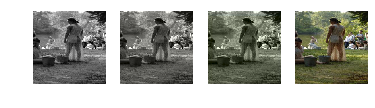

00003502.jpg


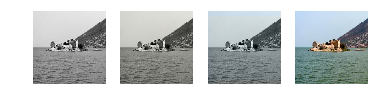

00002146.jpg


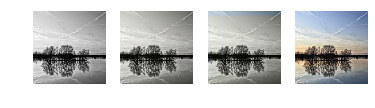

00002493.jpg


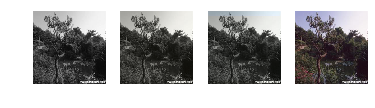

00000995.jpg


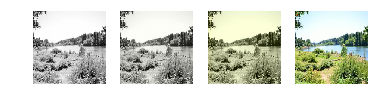

00003023.jpg


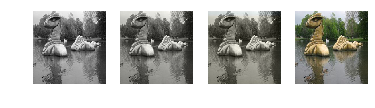

00004837.jpg


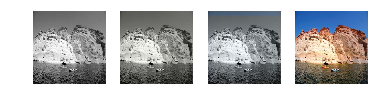

00002353.jpg


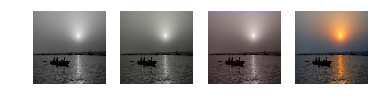

00000993.jpg


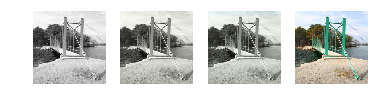

00000123.jpg


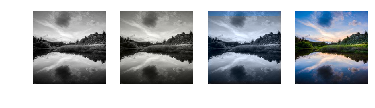

00002740.jpg


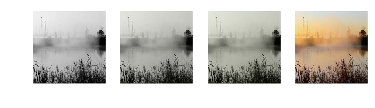

00000664.jpg


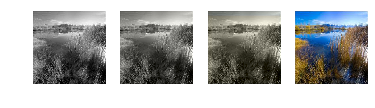

00004882.jpg


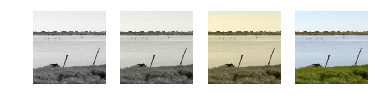

00001553.jpg


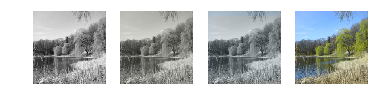

00002462.jpg


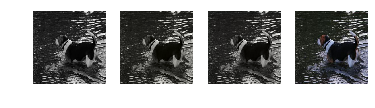

00004306.jpg


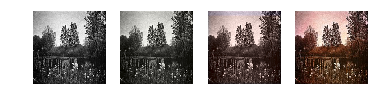

00003042.jpg


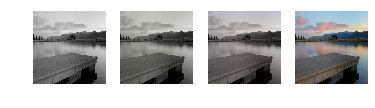

00002678.jpg


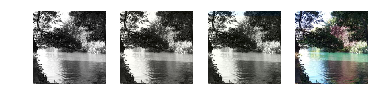

00001213.jpg


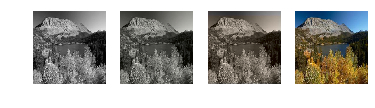

00002115.jpg


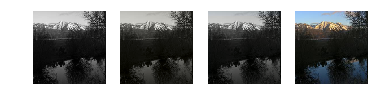

00000243.jpg


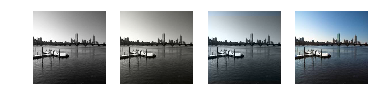

00001567.jpg


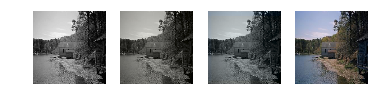

00004057.jpg


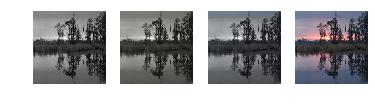

00004993.jpg


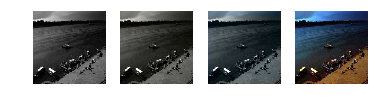

00004756.jpg


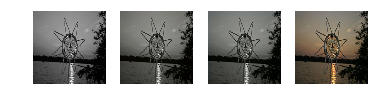

00004761.jpg


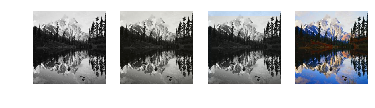

00000597.jpg


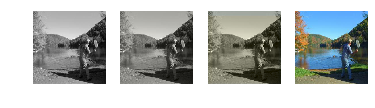

00002880.jpg


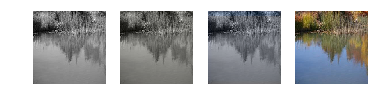

00004100.jpg


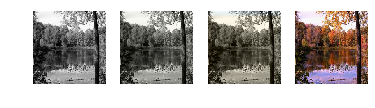

00001061.jpg


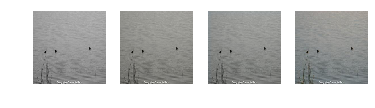

00003977.jpg


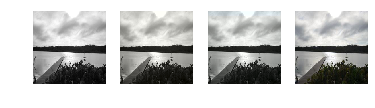

00002824.jpg


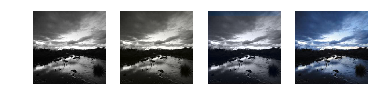

00000034.jpg


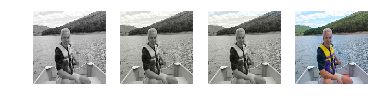

00003442.jpg


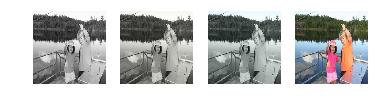

00004245.jpg


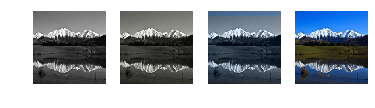

00001016.jpg


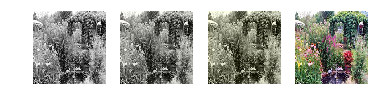

00003515.jpg


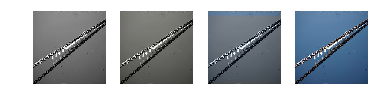

00003120.jpg


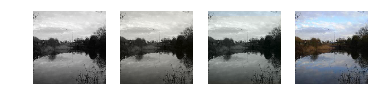

00004892.jpg


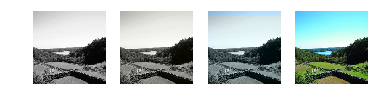

00003866.jpg


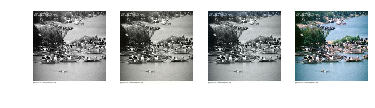

00004450.jpg


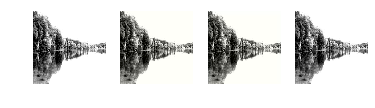

00004178.jpg


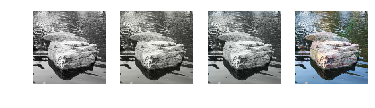

00003995.jpg


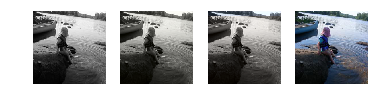

00002600.jpg


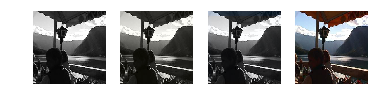

00000014.jpg


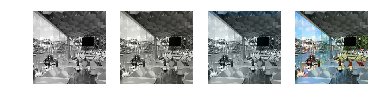

00000712.jpg


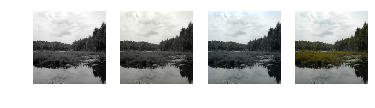

00001502.jpg


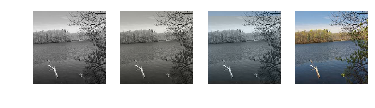

00003579.jpg


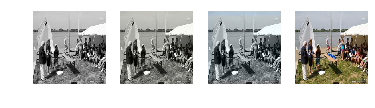

00000457.jpg


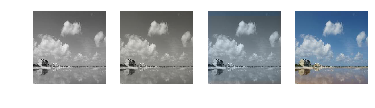

00002692.jpg


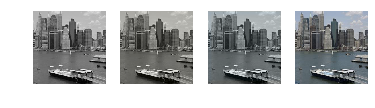

00001062.jpg


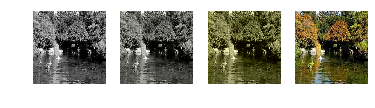

00000250.jpg


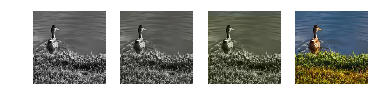

00004560.jpg


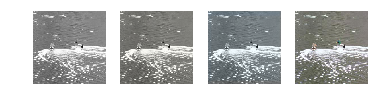

00004851.jpg


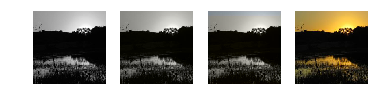

00004839.jpg


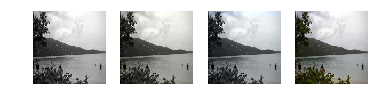

00002060.jpg


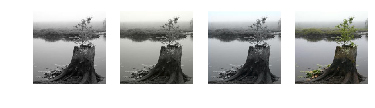

00003113.jpg


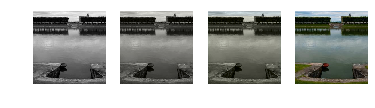

00003622.jpg


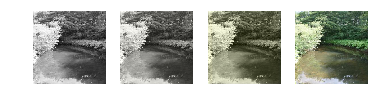

00000079.jpg


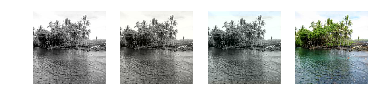

00000320.jpg


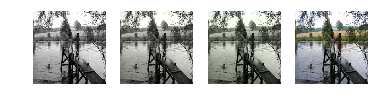

00004553.jpg


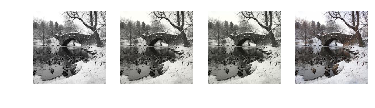

00002682.jpg


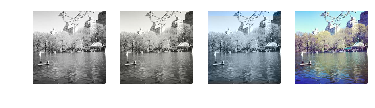

00000914.jpg


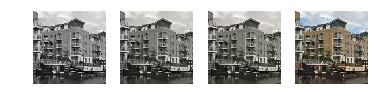

00003531.jpg


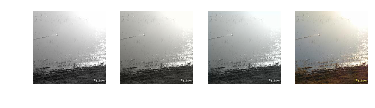

00004583.jpg


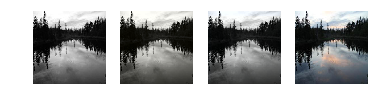

00004075.jpg


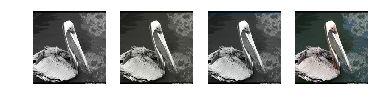

00001782.jpg


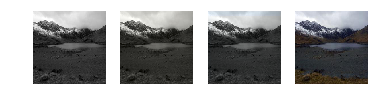

00002915.jpg


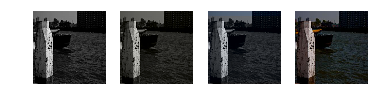

00004373.jpg


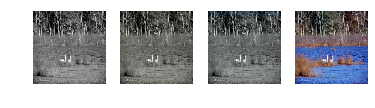

00002722.jpg


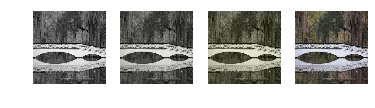

00002012.jpg


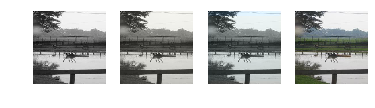

00002084.jpg


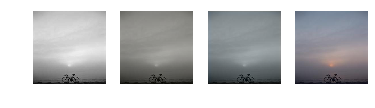

00003197.jpg


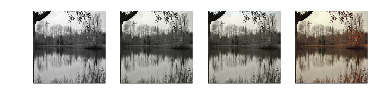

00004592.jpg


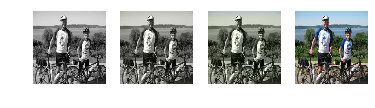

00004068.jpg


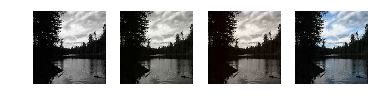

00002399.jpg


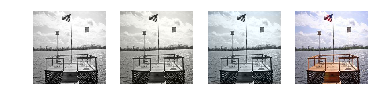

00002030.jpg


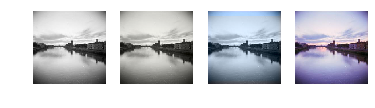

00001497.jpg


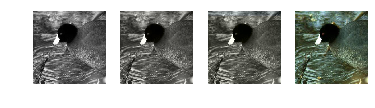

00003606.jpg


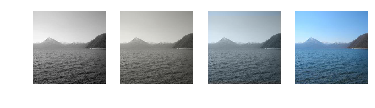

00004165.jpg


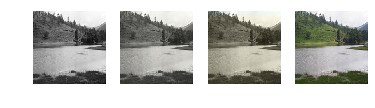

00001283.jpg


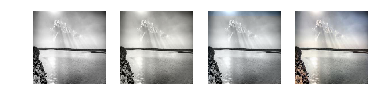

00000558.jpg


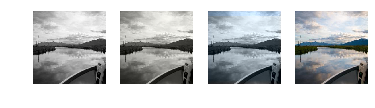

00001223.jpg


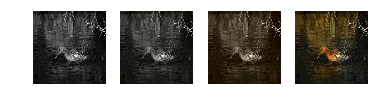

00003174.jpg


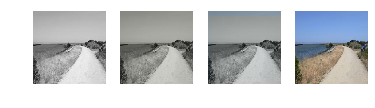

00002383.jpg


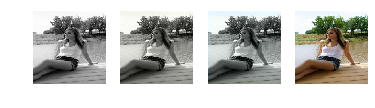

00001356.jpg


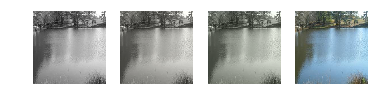

00001599.jpg


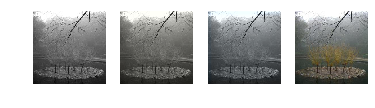

00003629.jpg


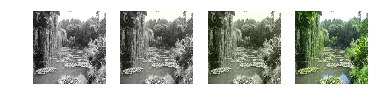

00000773.jpg


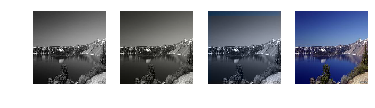

00004055.jpg


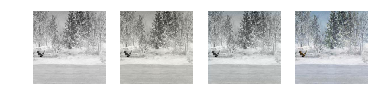

00004203.jpg


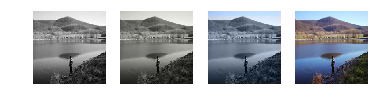

00003272.jpg


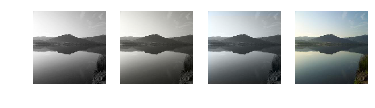

00004967.jpg


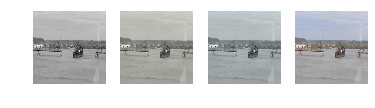

00003390.jpg


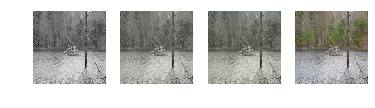

00003013.jpg


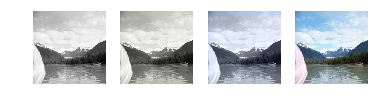

00001997.jpg


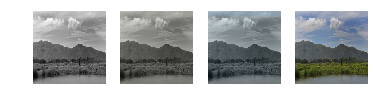

00001002.jpg


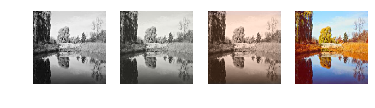

00003363.jpg


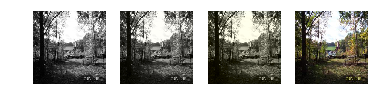

00000918.jpg


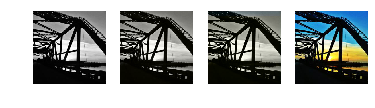

00001552.jpg


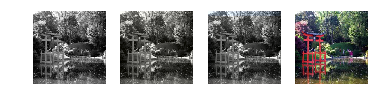

00000323.jpg


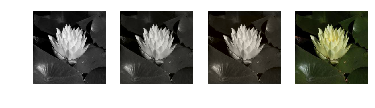

00000395.jpg


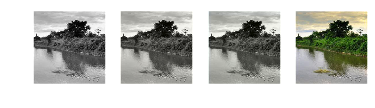

00004077.jpg


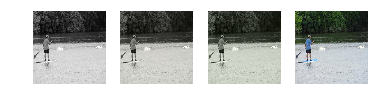

00004619.jpg


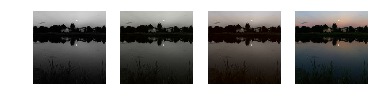

00000281.jpg


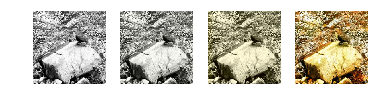

00002379.jpg


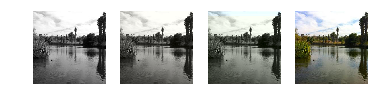

00003870.jpg


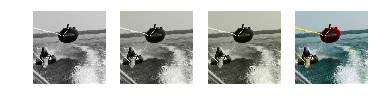

00004641.jpg


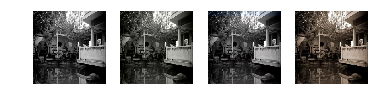

00002735.jpg


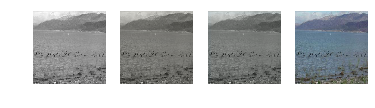

00001944.jpg


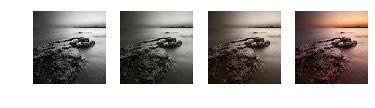

00001955.jpg


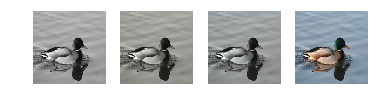

00002611.jpg


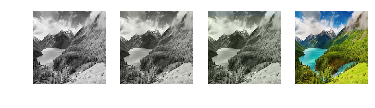

00004929.jpg


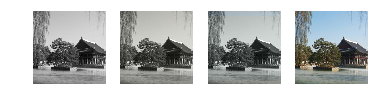

00000525.jpg


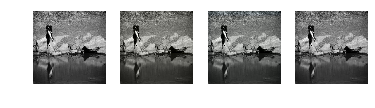

00004847.jpg


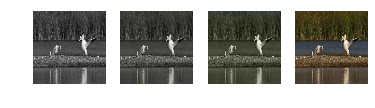

00000200.jpg


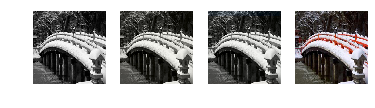

00003878.jpg


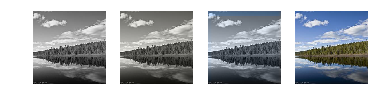

00002359.jpg


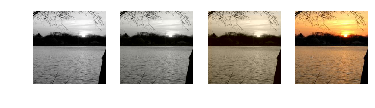

00000710.jpg


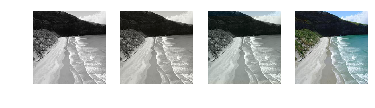

00004861.jpg


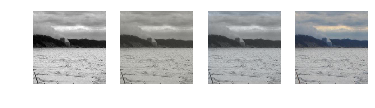

00003254.jpg


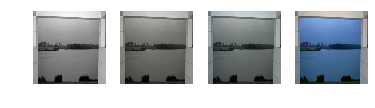

00004768.jpg


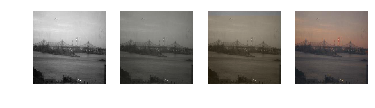

00002116.jpg


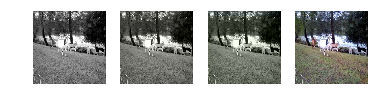

00004622.jpg


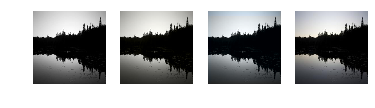

00001716.jpg


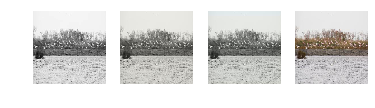

00002319.jpg


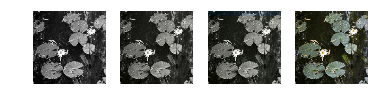

00004383.jpg


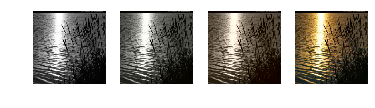

00002971.jpg


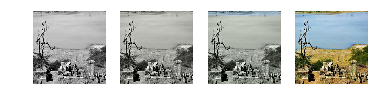

00002275.jpg


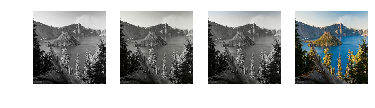

00002273.jpg


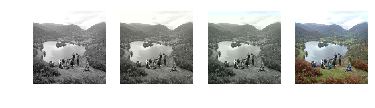

00004436.jpg


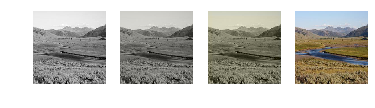

00000491.jpg


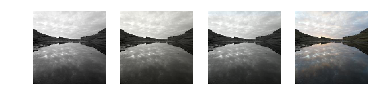

00001623.jpg


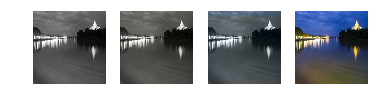

00001661.jpg


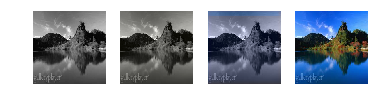

00002332.jpg


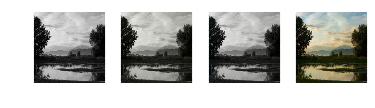

00002542.jpg


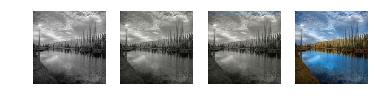

00001212.jpg


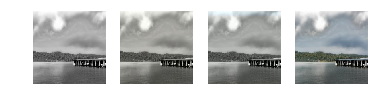

00002790.jpg


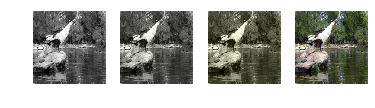

00001793.jpg


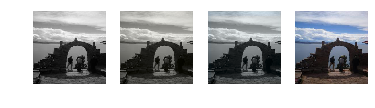

00003924.jpg


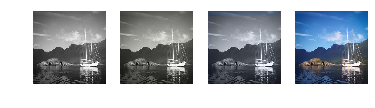

00004716.jpg


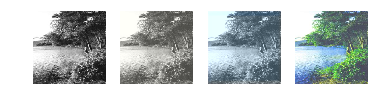

00000352.jpg


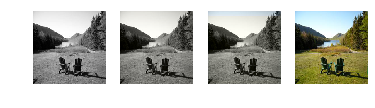

00001109.jpg


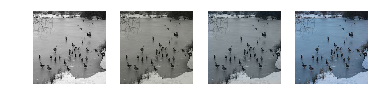

00000147.jpg


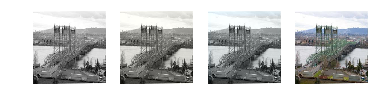

00000854.jpg


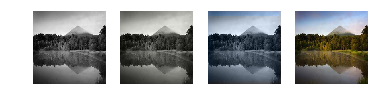

00003114.jpg


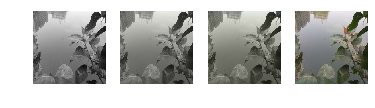

00002446.jpg


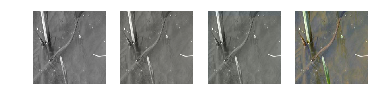

00004294.jpg


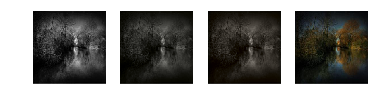

00002761.jpg


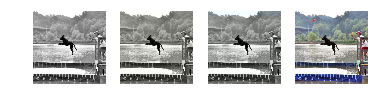

00000815.jpg


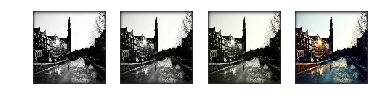

00001542.jpg


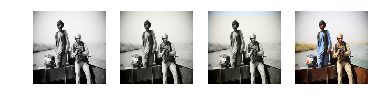

00000917.jpg


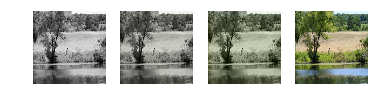

00001319.jpg


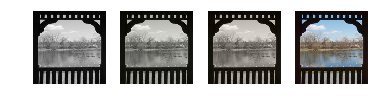

00000936.jpg


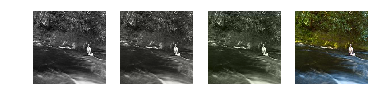

00003099.jpg


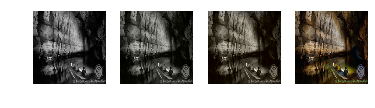

00003917.jpg


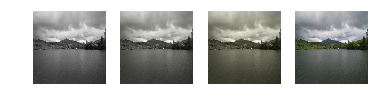

00001996.jpg


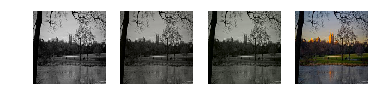

00004380.jpg


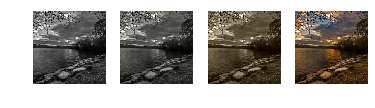

00000713.jpg


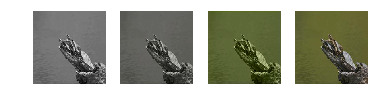

00004182.jpg


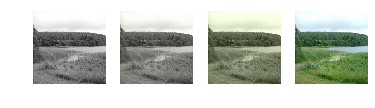

00002768.jpg


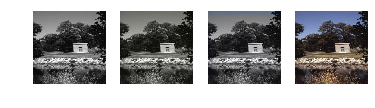

00001237.jpg


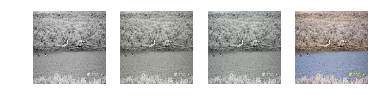

00004496.jpg


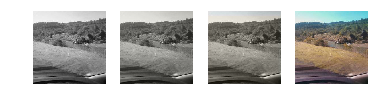

00000403.jpg


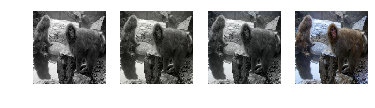

00000263.jpg


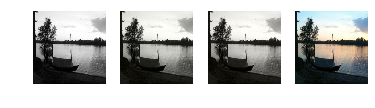

00002728.jpg


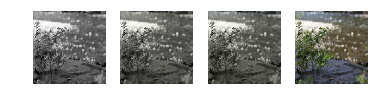

00002642.jpg


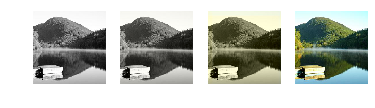

00001631.jpg


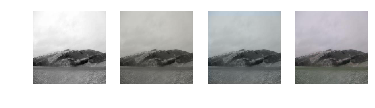

00004320.jpg


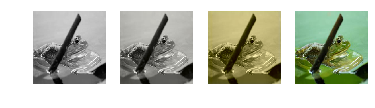

00002350.jpg


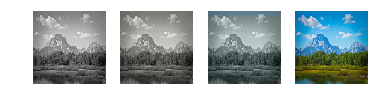

00001376.jpg


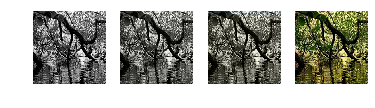

00002104.jpg


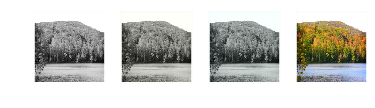

00002519.jpg


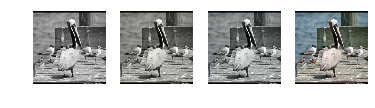

00000216.jpg


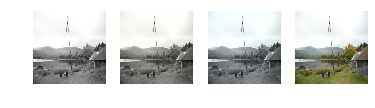

00002980.jpg


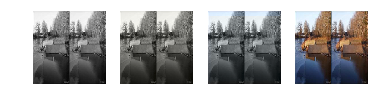

00002849.jpg


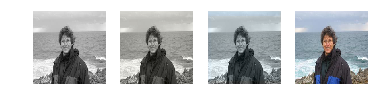

00002045.jpg


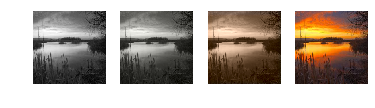

00000592.jpg


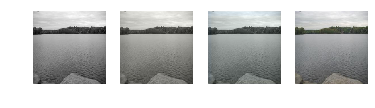

00002205.jpg


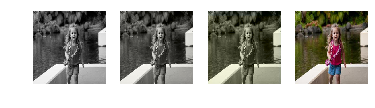

00002374.jpg


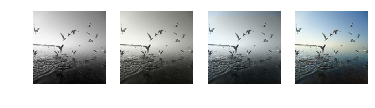

00001665.jpg


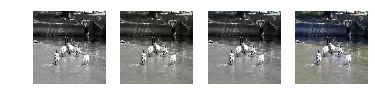

00003182.jpg


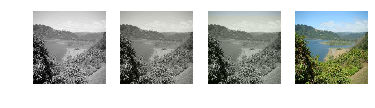

00001044.jpg


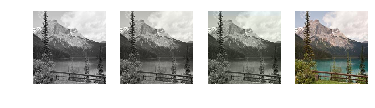

00000122.jpg


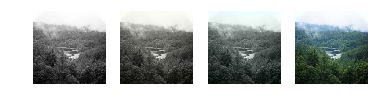

00004089.jpg


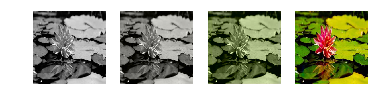

00004125.jpg


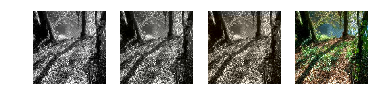

00000877.jpg


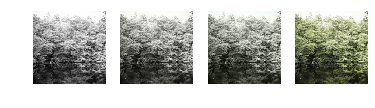

00002339.jpg


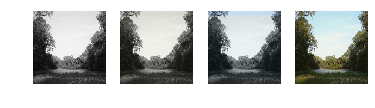

00002843.jpg


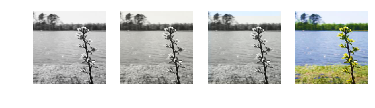

00000905.jpg


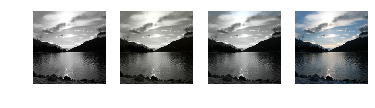

00002881.jpg


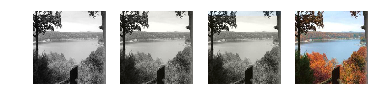

00003223.jpg


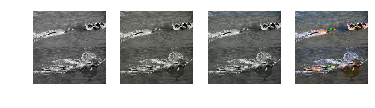

00002407.jpg


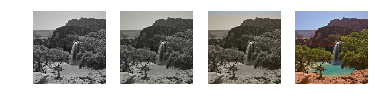

00000283.jpg


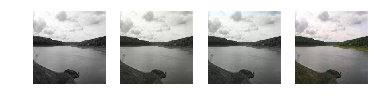

00000953.jpg


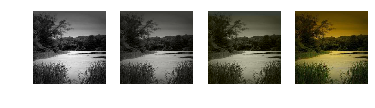

00000129.jpg


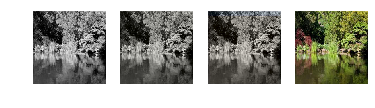

00000390.jpg


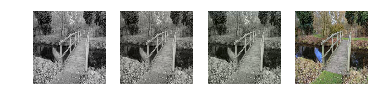

00004409.jpg


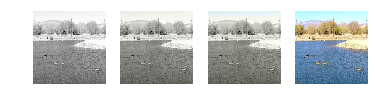

00003160.jpg


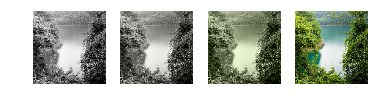

00000354.jpg


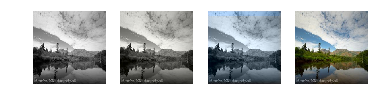

00001487.jpg


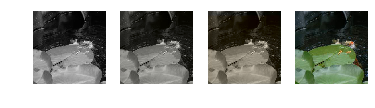

00002837.jpg


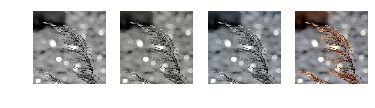

00001510.jpg


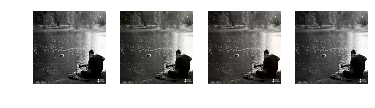

00001871.jpg


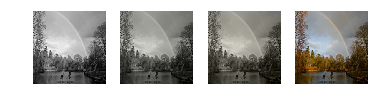

00003786.jpg


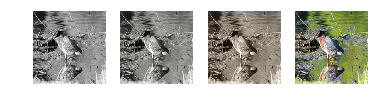

00000013.jpg


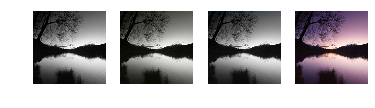

00004596.jpg


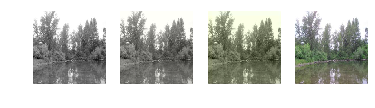

00001803.jpg


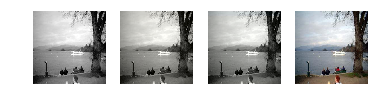

00000602.jpg


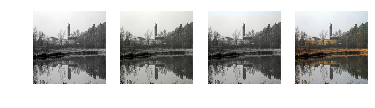

00004862.jpg


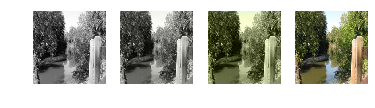

00001590.jpg


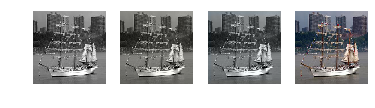

00002846.jpg


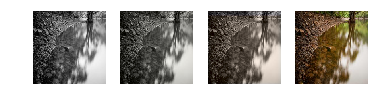

00002839.jpg


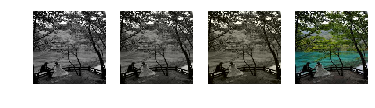

00001359.jpg


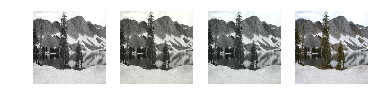

00001967.jpg


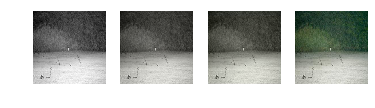

00002074.jpg


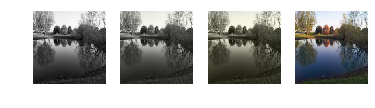

00003237.jpg


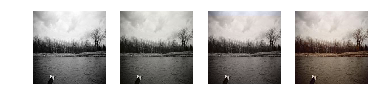

00001892.jpg


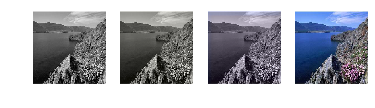

00003303.jpg


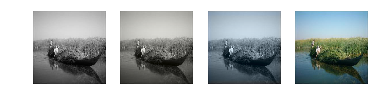

00003565.jpg


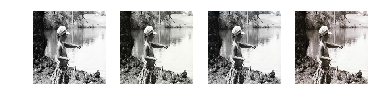

00002643.jpg


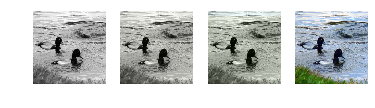

00001013.jpg


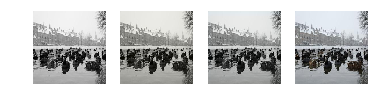

00001139.jpg


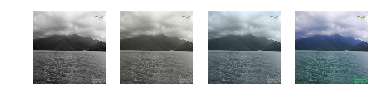

00000512.jpg


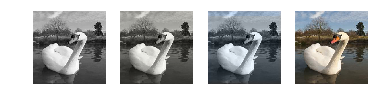

00000104.jpg


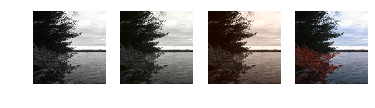

00002641.jpg


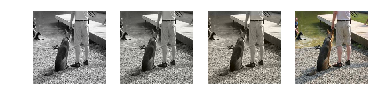

00004573.jpg


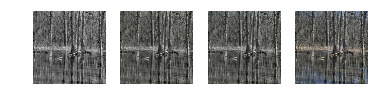

00000560.jpg


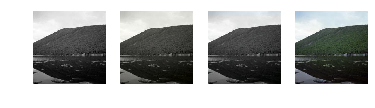

00003359.jpg


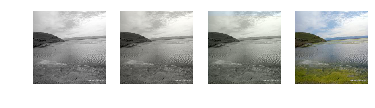

00000629.jpg


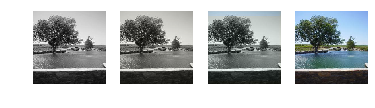

00003167.jpg


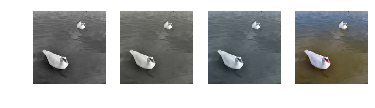

00000077.jpg


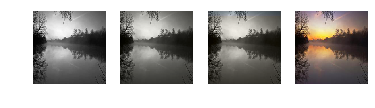

00004047.jpg


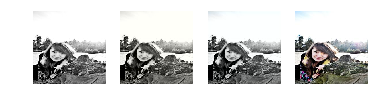

00003645.jpg


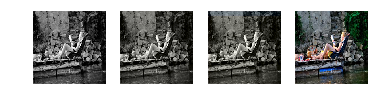

00001874.jpg


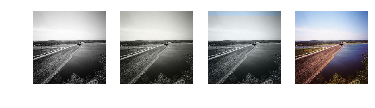

00000623.jpg


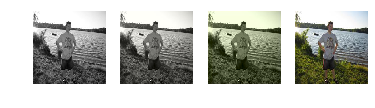

00003176.jpg


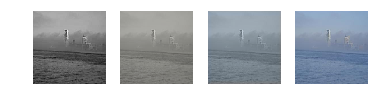

00003491.jpg


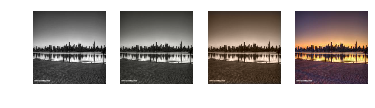

00000605.jpg


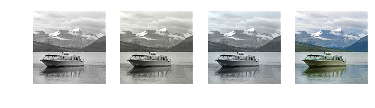

00004434.jpg


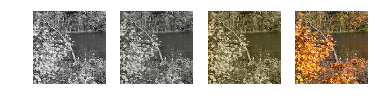

00002857.jpg


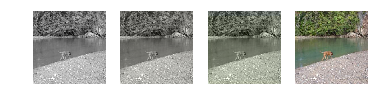

00004961.jpg


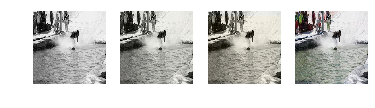

00004898.jpg


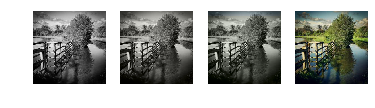

00003540.jpg


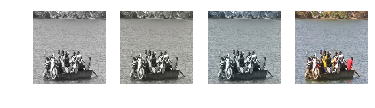

00003434.jpg


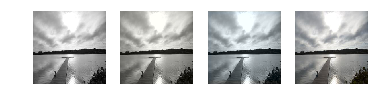

00000319.jpg


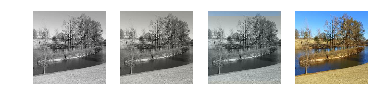

00000619.jpg


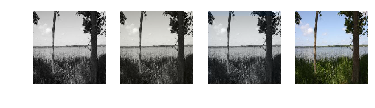

00000355.jpg


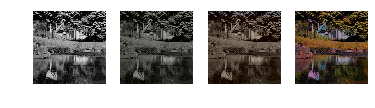

In [20]:
path = './unzipped_images/lake/'
files = os.listdir(path)[-500:]
for i in range(len(files)):
    print(files[i])
    fig = plt.figure()
    fig.add_subplot(141)
    plt.gca().axis('off')
    show_gray_image(X[i])
    imsave('./unzipped_images/lake_val/grayscale/'+files[i], turn_gray(X[i]*255))
    fig.add_subplot(142)
    plt.gca().axis('off')
    plt.imshow(recolored_images_worse[i])
    imsave('./unzipped_images/lake_val/worse/'+files[i], recolored_images_worse[i])
    fig.add_subplot(143)
    plt.gca().axis('off')
    plt.imshow(recolored_images[i])
    imsave('./unzipped_images/lake_val/final/'+files[i], recolored_images[i])
    fig.add_subplot(144)
    plt.gca().axis('off')
    plt.imshow(X[i])
    plt.show()

In [21]:
len(files)

500